<a href="https://colab.research.google.com/github/Martelll/ma_le/blob/master/Lungu_GPU_HW_3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Домашнее задание \ проект

В данном проекте вам нужно будет провести стандартную работу - загрузить данные, поисследовать их, сделать модельку. Сразу оговорюсь, что подбор параметров, интересные архитектуры...на это я внимания обращать не буду, у нас курс не про ML. Главное - это использования GPU. Что нужно?

    1) Загрузить данны при помощи cudf\dask-cudf
    2) Произвести базовый анализ данных (распределение классов, средние значения фичей по классам и вот это вот все). Любые преобразования данных на ваше усмотрение (только комментируйте=) )
    3) Попробуйте в ходе анализа \ обработки найти применение cuda.jit и cupy (достаточно по 1 примеру, даже искуственному)
    4) Взять два метода снижения размерности из cuml (на лекции был UMAP, еще есть tSNE, tSVD, PCA...), обучить их и визуализировать наши классы в пространстве размерности 2 (раскрасить классы будет хорошей идеей)
    5) Обучите нейронку на GPU\Multi-GPU, а также какую-нибудь еще модельку на GPU\Multi-GPU.

Если в пункте 5 будет Multi-GPU - это дополнительные баллы, а также если еще добавите, например, метод кластеризации просто для сравнения =)

P.S. прошу в коде давать комментарии того, что делаете. Пункты 4 и 5 также зачту за домашку 3 занятия.

Данные находятся в файле Train_Set_90621.csv
Amount Defaulted - эту переменную нужно удалить=)

И все на GPU, никаких любимых pandas, numpy и прочего)) Думаю, из описания понятно, как я буду оценивать работу)

Цель всего этого - чтобы вы побольше потыкали GPU

In [ ]:
import cudf
import cupy as cp
from numba import cuda
#import hvplot.cudf
import holoviews as hv
import os

os.environ['HV_DOC_HTML'] = 'true'

In [ ]:
import matplotlib as mpl
import matplotlib.pyplot as plt

## Смотрим всякое

In [ ]:
df = cudf.read_csv('Train_Set_90621.csv')

In [ ]:
df.shape

(195118, 29)

In [ ]:
print(df.shape)
print(df.columns)
df.head()

(195118, 29)
Index(['Application ID', 'Bank Masked', 'Bank Type', 'Approved_Timestamp',
       'Name Masked', 'Business Owner State', 'Business_Industry_Type_Code',
       'Approved_Year', 'New Business', 'Term', 'BankState', 'Interest Rate',
       'Employees', 'Gross Disbursed Amount', 'Term_years', 'Jobs Retained',
       'Male to Female Employees Ratio', 'Expected Company Income',
       'Funds available with company', 'Gross_Apprv_Amount',
       'Company Branch Code', 'City or Rural', 'Jobs Generated',
       'Carry-forward Credit', 'Documents Provided', 'Balance Left',
       'Amount Defaulted', 'Final_Appved_Amount', 'Default_Status'],
      dtype='object')


,Application ID,Bank Masked,Bank Type,Approved_Timestamp,Name Masked,Business Owner State,Business_Industry_Type_Code,Approved_Year,New Business,Term,...,Gross_Apprv_Amount,Company Branch Code,City or Rural,Jobs Generated,Carry-forward Credit,Documents Provided,Balance Left,Amount Defaulted,Final_Appved_Amount,Default_Status
0,1020200001,Bank_Name_316,Private,12-10-2005,Business_Name_10007,Uttar Pradesh,525161,2005,1,219,...,18550000,25650,1,3,N,N,0,0,13912500,0
1,1020200002,Bank_Name_1062,Govt,21-11-2006,Business_Name_130906,Uttar Pradesh,1231,2006,1,71,...,2450000,0,1,0,Y,N,0,2369500,1225000,1
2,1020200003,Bank_Name_39,Private,28-11-2007,Business_Name_105953,Uttar Pradesh,322442,2007,2,84,...,1750000,0,2,2,Y,N,0,0,1487500,0
3,1020200004,Bank_Name_3,Govt,18-04-2009,Business_Name_103197,Kerala,1231,2009,1,300,...,38850000,1,1,0,N,N,0,0,29137500,0
4,1020200005,Bank_Name_126,Govt,23-11-2002,Business_Name_118932,Delhi,1231,2002,2,153,...,2800000,1,2,0,N,Y,0,0,2380000,0


In [ ]:
df['Balance Left'].unique()

0          0
1    1750000
2      42000
Name: Balance Left, dtype: int64

In [ ]:
df.isnull().sum()

Application ID                      0
Bank Masked                        80
Bank Type                          80
Approved_Timestamp                426
Name Masked                         1
Business Owner State                3
Business_Industry_Type_Code         0
Approved_Year                       0
New Business                       36
Term                                0
BankState                          81
Interest Rate                       0
Employees                           0
Gross Disbursed Amount              0
Term_years                          0
Jobs Retained                       0
Male to Female Employees Ratio      0
Expected Company Income             3
Funds available with company        0
Gross_Apprv_Amount                  0
Company Branch Code                 0
City or Rural                       0
Jobs Generated                      0
Carry-forward Credit              978
Documents Provided                552
Balance Left                        0
Amount Defau

In [ ]:
df.dtypes

Application ID                      int64
Bank Masked                        object
Bank Type                          object
Approved_Timestamp                 object
Name Masked                        object
Business Owner State               object
Business_Industry_Type_Code         int64
Approved_Year                       int64
New Business                        int64
Term                                int64
BankState                          object
Interest Rate                       int64
Employees                           int64
Gross Disbursed Amount              int64
Term_years                          int64
Jobs Retained                       int64
Male to Female Employees Ratio      int64
Expected Company Income             int64
Funds available with company        int64
Gross_Apprv_Amount                  int64
Company Branch Code                 int64
City or Rural                       int64
Jobs Generated                      int64
Carry-forward Credit              

In [ ]:
del df['Amount Defaulted']

In [ ]:
print(df['Default_Status'].mean())
print(cp.array(df['Default_Status']).mean())

0.18059840711774414
0.18059840711774414


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
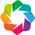

:Curve   [Male to Female Employees Ratio]   (Default_Status)

In [ ]:
#Посмотрим как много мужиков влияют на успех компании
ratio_def = df.groupby(by='Male to Female Employees Ratio', as_index=False).mean()[['Male to Female Employees Ratio','Default_Status']]
ratio_def = ratio_def.sort_values(by='Male to Female Employees Ratio')

hv.extension('bokeh')
hv.Curve(ratio_def, 'Male to Female Employees Ratio', 'Default_Status').opts(
     title="heh", width=800, height=400)

In [ ]:
#Функция создает бинарную переменную: 1 - пропуск 0 - что-то есть
#Пример получился игрушечным, т.к. она отказывается работать на переменных с пропусками из-за их типов

@cuda.jit
def one_if_not_none(in_col, out_col):
    i = cuda.grid(1)
    if i < in_col.size:
        if i == cp.nan:
            out_col[i] = 1
        else:
            out_col[i] = 0

size = len(df['City or Rural'])
df['isna City or Rural'] = 0.0
one_if_not_none.forall(size)(df['City or Rural'], df['isna City or Rural'])

df['isna City or Rural'].mean()

0.0

In [ ]:
df = df.dropna()

## Понижаем размерность

In [ ]:
from cuml.decomposition import PCA
from cuml.decomposition import TruncatedSVD as SVD

In [ ]:
numerics = ['int16', 'int32', 'int64', 'float16', 'float32', 'float64']
df_num = df.select_dtypes(include=numerics)
df_num = df_num.astype({col: 'float32' for col in df_num.select_dtypes('int64').columns})
del df_num['Application ID']
del df_num['Default_Status']

In [ ]:
pca = PCA(n_components=2).fit(df_num)
df_embeddings = pca.transform(df_num)

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
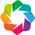

:Scatter   [x]   (y,target)

In [ ]:
df_embeddings['target'] = df['Default_Status']
df_embeddings.columns = ['x', 'y', 'target']

hv.extension('bokeh')
hv.Scatter(
    data=df_embeddings, kdims=['x'], vdims=['y', 'target'],
).opts(color='target', cmap=['blue', 'orange'], width=600, height=600)

In [ ]:
svd = SVD(n_components=2).fit(df_num)
df_embeddings_svd = svd.transform(df_num)

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
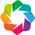

:Scatter   [x]   (y,target)

In [ ]:
df_embeddings_svd['target'] = df['Default_Status']
df_embeddings_svd.columns = ['x', 'y', 'target']

hv.extension('bokeh')
hv.Scatter(
    data=df_embeddings_svd, kdims=['x'], vdims=['y', 'target'],
).opts(color='target', cmap=['black', 'red'], width=600, height=600)

## Учим нейронку


In [ ]:
import torch
from torch.nn import functional as F
from torch import nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader, DistributedSampler
import pytorch_lightning as pl
import numpy as np
from torchvision import datasets, transforms
import os
from tqdm.auto import tqdm
import contextlib

import warnings
warnings.filterwarnings("ignore")

In [ ]:
BATCH_SIZE = 512
N_EPOCHS = 1
LEARNING_RATE = 1e-3

In [ ]:
class CustomTrainDataset():
  def __init__(self, df):
    x = df.iloc[:,0:2].values
    y = df.iloc[:,2].values

    self.x_train=torch.tensor(x,dtype=torch.float32)
    self.y_train=torch.tensor(y,dtype=torch.float32)

  def __len__(self):
    return len(self.y_train)

  def __getitem__(self,idx):
    return self.x_train[idx],self.y_train[idx]

In [ ]:
#Учится будем на эмбеддингах из предыдущего пункта

train_datast = CustomTrainDataset(df_embeddings_svd)

transform=transforms.Compose([
        transforms.ToTensor(),
        transforms.Normalize((0.1307,), (0.3081,))
    ])

train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True, num_workers=2)

In [ ]:
#Скрипт обучения взял из семинара

def accuracy(true, pred):
    return sum(pred == true) / len(pred)

class Flatten(nn.Module):
    def forward(self, x):
        return x.view(x.size(0), -1)

class PytorchModel(torch.nn.Module):
    def __init__(self):
        super(PytorchModel, self).__init__()
        self.sequential_module = nn.Sequential(
            nn.Conv2d(in_channels=1, out_channels=16, kernel_size=3, padding=1),
            nn.BatchNorm2d(16),
            nn.ReLU(inplace=False),
            nn.Conv2d(in_channels=16, out_channels=32, kernel_size=3, padding=1),
            nn.ReLU(inplace=False),
            nn.MaxPool2d(kernel_size=2, stride=2),

            nn.Conv2d(in_channels=32, out_channels=64, kernel_size=3, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=False),
            nn.Conv2d(in_channels=64, out_channels=64, kernel_size=3, padding=1),
            nn.ReLU(inplace=False),
            nn.MaxPool2d(kernel_size=2, stride=2),

            nn.Conv2d(in_channels=64, out_channels=128, kernel_size=3, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(inplace=False),
            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=3, padding=1),
            nn.ReLU(inplace=False),
            nn.MaxPool2d(kernel_size=2, stride=2),

            Flatten(),

            nn.Linear(1152, 64),
            nn.ReLU(inplace=False),
            nn.Linear(64, 32),
            nn.ReLU(inplace=False),
            nn.Dropout(p=0.5),
            nn.Linear(32, 10)
        )

    def forward(self, x):
        x = self.sequential_module(x)
        x = F.log_softmax(x, dim=-1)
        return x

In [ ]:
class TrainModel():

    def __init__(self, device='cpu', dp=False):
        self.learning_rate = LEARNING_RATE
        self.n_epochs = N_EPOCHS
        self.device = device
        self.model = PytorchModel()
        if self.device != 'cpu':
            self.model.to(self.device)
            if dp:
                self.model = nn.DataParallel(self.model)
        self.optimizer = torch.optim.Adam(self.model.parameters(), lr=self.learning_rate)

    def run_train(self, train_loader):
        all_preds = []
        all_facts = []

        self.criterion = nn.NLLLoss()
        for epoch in range(self.n_epochs):
            self.model.train()
            for x, y in tqdm(train_loader):

                if self.device != 'cpu':
                    x = x.to(self.device)
                    y = y.to(self.device)

                self.model.zero_grad()
                y_pred = self.model(x)

                loss = self.criterion(y_pred, y)
                loss.backward()

                y_pred = y_pred.argmax(dim=1, keepdim=True)
                y_pred = torch.squeeze(y_pred)

                all_preds.extend(y_pred.cpu().detach().numpy())
                all_facts.extend(y.cpu().detach().numpy())

                self.optimizer.step()

            print(f'epoch = {epoch}, accuracy = {accuracy(np.array(all_preds), np.array(all_facts))}')
        return self

In [ ]:
pytorch_model = TrainModel(device='cuda')
pytorch_model = pytorch_model.run_train(train_loader)

  0%|          | 0/118 [00:00<?, ?it/s]

epoch = 0, accuracy = 0.69245


## Учим catboost

In [ ]:
from catboost import CatBoostClassifier, Pool
import pandas as pd

In [ ]:
x = Pool(df_embeddings_svd.iloc[:,0:2].to_numpy())
y = Pool(df_embeddings_svd.iloc[:,2].to_numpy())

In [ ]:
train = Pool(df_embeddings_svd.iloc[:,0:2].to_numpy(), df_embeddings_svd.iloc[:,2].to_numpy())

In [ ]:
gpu_catboost = CatBoostClassifier(iterations=100, task_type='GPU', devices='0')\
                                 .fit(train, verbose=10)

Learning rate set to 0.198638
0:	learn: 0.6175542	total: 11.1ms	remaining: 1.1s
10:	learn: 0.4621811	total: 62.4ms	remaining: 505ms
20:	learn: 0.4561365	total: 113ms	remaining: 425ms
30:	learn: 0.4544535	total: 161ms	remaining: 358ms
40:	learn: 0.4533257	total: 212ms	remaining: 306ms
50:	learn: 0.4525632	total: 251ms	remaining: 241ms
60:	learn: 0.4520758	total: 289ms	remaining: 185ms
70:	learn: 0.4515093	total: 327ms	remaining: 134ms
80:	learn: 0.4510274	total: 368ms	remaining: 86.3ms
90:	learn: 0.4505953	total: 405ms	remaining: 40.1ms
99:	learn: 0.4502519	total: 438ms	remaining: 0us
